# Introduction to Image Augmentation using torchvision

In this notebook, we will explore the `torchvision.transforms.v2` module, which provides a suite of image transformation functions that are commonly used in computer vision tasks.

In older tutorials online, you may see `torchvision.transforms` being used. However, the recent versions of torchvision has introduced `torchvision.transforms.v2`, which is more efficient and user-friendly, and officially recommended by PyTorch.

To start, make sure you have a recent version of torchvision and PyTorch installed. Follow PyTorch.org instructions if you haven't installed them yet. The installation command differs for each OS.

In [7]:
import torch
import torchvision
import torchvision.transforms.v2 as T # Standard alias for transforms
from PIL import Image # Pillow library for image manipulation
import matplotlib.pyplot as plt
import numpy as np # For unnormalization visualization
from modelscope.models.cv.tinynas_detection.damo.augmentations.box_level_augs.color_augs import \
    brightness

### --- Helper Function for Visualization ---

In [48]:
def show_image(image, title="Image", unnormalize=False, mean=None, std=None):
    """Helper function to display a PIL image or a Tensor."""
    if isinstance(image, torch.Tensor):
        # If it's a tensor, convert it to a NumPy array
        # If it needs unnormalization, do that first
        if unnormalize and mean is not None and std is not None:
            # Clone the tensor to avoid modifying the original
            image = image.clone()
            # Convert mean and std to tensors
            mean = torch.tensor(mean).view(3, 1, 1)
            std = torch.tensor(std).view(3, 1, 1)
            # Unnormalize: image = (image * std) + mean
            image.mul_(std).add_(mean)
            # Clamp values to [0, 1] in case of floating point inaccuracies
            image = torch.clamp(image, 0, 255)
            image = image.type(torch.uint8)  # Convert to uint8

        # PyTorch tensors are typically (C, H, W), matplotlib expects (H, W, C) or (H, W)
        image = image.numpy().transpose((1, 2, 0))

        # If the image was originally grayscale and became (1, H, W), squeeze the channel dim
        if image.shape[2] == 1:
            image = image.squeeze(2)

    plt.imshow(image)
    plt.title(title)
    plt.axis('off') # Hide axes
    plt.show()

## Loading the image

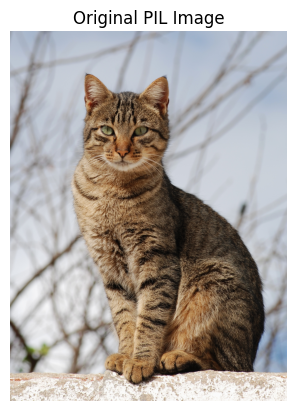

In [5]:
image_path = 'cat.jpg'
original_pil_image = Image.open(image_path).convert('RGB') # Load and ensure 3 channels (RGB)
show_image(original_pil_image, title="Original PIL Image")

## Converting to Tensor

Use T.ToImage() to convert a PIL Image to a PyTorch Tensor in (C, H, W) format, with uint8 data type.

Tensor shape: torch.Size([3, 2397, 1795])
Tensor dtype: torch.uint8


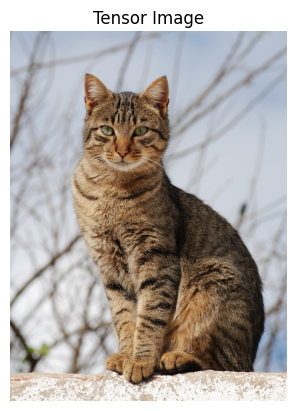

In [10]:
transform_to_tensor = T.ToImage()
tensor_image = transform_to_tensor(original_pil_image)
print(f"Tensor shape: {tensor_image.shape}")
print(f"Tensor dtype: {tensor_image.dtype}")
show_image(tensor_image, title="Tensor Image", unnormalize=True)

## Resizing

Resized Tensor shape: torch.Size([3, 128, 128])


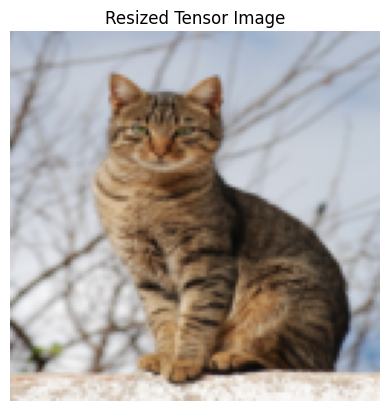

In [12]:
transform_resize = T.Resize(size=(128, 128), antialias=True)
tensor_image = transform_resize(tensor_image)
print(f"Resized Tensor shape: {tensor_image.shape}")
show_image(tensor_image, title="Resized Tensor Image", unnormalize=True)

## Image augmentations

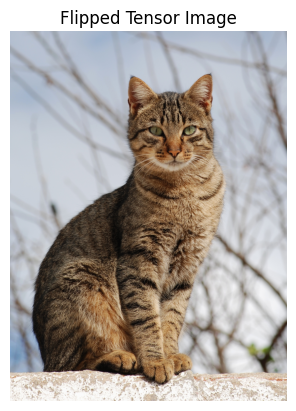

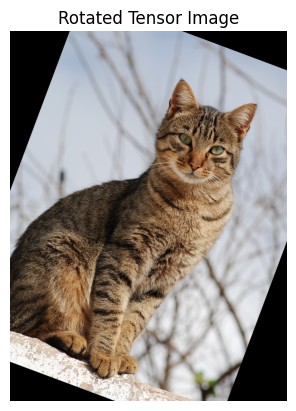

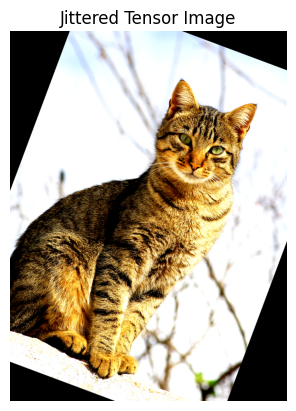

In [39]:
tensor_image = transform_to_tensor(original_pil_image) # Reset to original image
transform_flip = T.RandomHorizontalFlip(p=1.0) # Use p=1.0 to ensure flip happens for demo, in real life do not use p=1.0!
transform_rotate = T.RandomRotation(degrees=45)  # in real life should start with a smaller angle. Here we use 45 degrees for ease of demo
transform_jitter = T.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0.2)

tensor_image = transform_flip(tensor_image)
show_image(tensor_image, title="Flipped Tensor Image", unnormalize=True)
tensor_image = transform_rotate(tensor_image)
show_image(tensor_image, title="Rotated Tensor Image", unnormalize=True)
tensor_image = transform_jitter(tensor_image)
show_image(tensor_image, title="Jittered Tensor Image", unnormalize=True)

## Preparing the final image for model training
Normally, you need to convert the images into float tensors as the model weights are in float. Then, you need to normalize the images to match the mean and std of the dataset that your model is pre-trained on (unless you are starting fresh but people seldom do that now).

Note that if you run the cell below repeatly, it will apply these effects repeatedly. To reset, you will need to call `transform_to_tensor(original_pil_image)` again to get the original image.

In [40]:
transform_to_float = T.ToDtype(torch.float32)
transform_normalize = T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # ImageNet mean and std as most models are pretrained on ImageNet
tensor_image = transform_to_float(tensor_image)
tensor_image = transform_normalize(tensor_image)
print(f"Final Tensor shape: {tensor_image.shape}")
print(f"Final Tensor dtype: {tensor_image.dtype}")
print(tensor_image[0, :5, :5])  # preview the pixel values

Final Tensor shape: torch.Size([3, 2397, 1795])
Final Tensor dtype: torch.float32
tensor([[-2.1179, -2.1179, -2.1179, -2.1179, -2.1179],
        [-2.1179, -2.1179, -2.1179, -2.1179, -2.1179],
        [-2.1179, -2.1179, -2.1179, -2.1179, -2.1179],
        [-2.1179, -2.1179, -2.1179, -2.1179, -2.1179],
        [-2.1179, -2.1179, -2.1179, -2.1179, -2.1179]])


## Constructing a pipeline
To construct a pipeline of transformations, you can use `torchvision.transforms.v2.Compose`. This allows you to chain multiple transformations together. This also improves the speed of execution as PyTorch will try to apply them without incurring additional memory overhead from intermediate tensors.

In addition, most torchvision operations support GPU acceleration as long as the input is a tensor that is already placed on GPU. Notably, `T.ToImage()` does not support because its input is a PIL Image, but all subsequent transformations does. Thus, if you are bottlenecked by preprocessing speed, you can consider doing `T.ToImage()` first, then move the resulting tensor to gpu using `to('cuda')` then run the T.Compose pipeline on GPU.

Final Tensor shape: torch.Size([3, 128, 128])
Final Tensor dtype: torch.float32
tensor([[312.2926, 312.2926, 312.2926, 312.2926, 312.2926],
        [312.2926, 312.2926, 312.2926, 312.2926, 312.2926],
        [312.2926, 312.2926, 312.2926, 312.2926, 312.2926],
        [312.2926, 312.2926, 312.2926, 312.2926, 312.2926],
        [312.2926, 312.2926, 312.2926, 312.2926, 312.2926]])


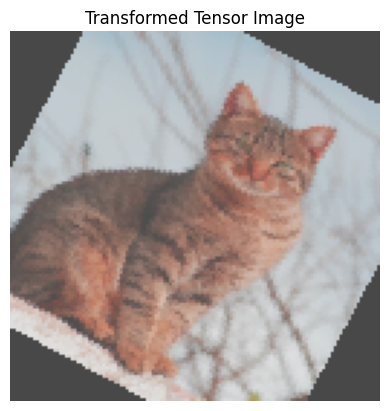

In [55]:
transforms = T.Compose([
    T.ToImage(),
    T.Resize(size=(128, 128), antialias=True),
    T.RandomHorizontalFlip(p=1.0),
    T.RandomRotation(degrees=45),
    T.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0.2),
    T.ToDtype(torch.float32),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
# Apply the transformations
tensor_image = transforms(original_pil_image)
print(f"Final Tensor shape: {tensor_image.shape}")
print(f"Final Tensor dtype: {tensor_image.dtype}")
print(tensor_image[0, :5, :5])  # preview the pixel values
show_image(tensor_image, title="Transformed Tensor Image", unnormalize=True, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

## Albumentations
Albumentations is an advanced image augmentation library built on top of `OpenCV` and operates on images in numpy arrays (not tensors). It offers a lot more image augmentation and preprocessing functions, and can be seamlessly integrated into existing `T.Compose` pipelines by simply adding a T.ToImage() to its output (np.array). It is also used by many repositories like Ultralytics which trains YOLO models.

To install, run `pip install -U albumentations`

Each Transform has a `p` parameter that controls the probability of that happening. It defaults to 0.5. Most Transforms has parameters that accept a tuple to specify a range to randomly pick from when applying the effect.

Unlike torchvision transforms, albumentations transforms returns results in a dictionary containing the 'image' key. This is because it supports transforming both the image and the label (e.g. bbox coordinates) at once, and returning a dict allows it to separate them.

Shape: (2397, 1795, 3)


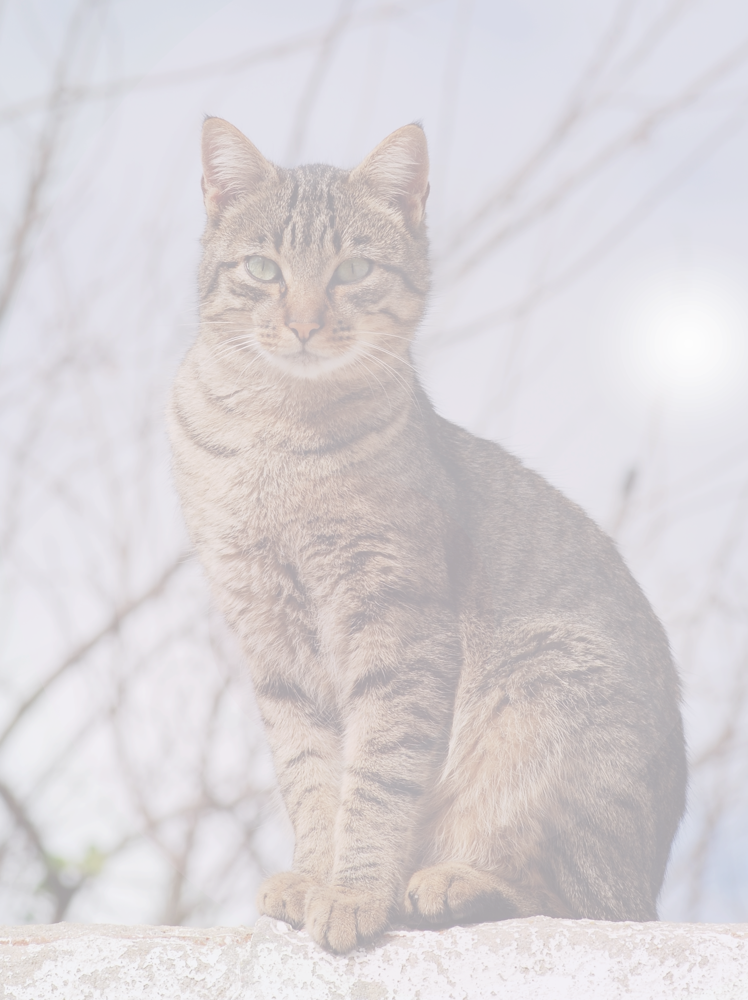

In [71]:
import albumentations as A  # common short-form of albumentations

np_image = np.array(original_pil_image)
print(f'Shape: {np_image.shape}')

# Transform
sunflare = A.RandomSunFlare(p=1)  # always set to 1 for demo
np_image = sunflare(image=np_image)['image']

# To display the image in Jupyter notebook/colab
from IPython.display import display
display(Image.fromarray(np_image))

Similar to T.Compose, albumentations transforms can also be composed into a pipeline. Note that you cannot mix torchvision Transforms with albumentations transforms as the former operates on PyTorch tensors while the latter operates on numpy arrays. However, since you can convert between both easily, it is possible to chain them. Most of the time, albumentations will offer all transformations one may need and torchvision transforms is not needed at all.

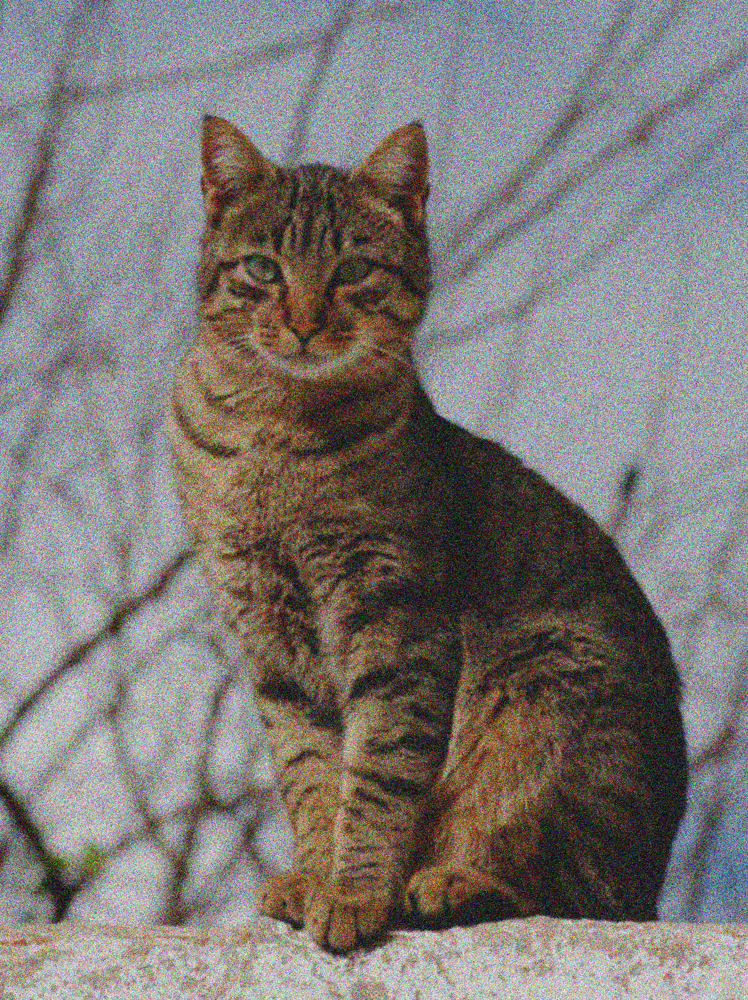

In [79]:
pipeline = A.Compose(
    [
        A.RandomBrightnessContrast(p=1), # 100% for demo only
        A.GaussianBlur(p=1),
        A.GaussNoise(p=1)
    ]
)

# apply the pipeline
np_image = np.array(original_pil_image)
np_image = pipeline(image=np_image)['image']
display(Image.fromarray(np_image))

## Tips on using Albumentations
While Albumentations is more flexible, it also lacks GPU acceleration, which means some transforms like `PiecewiseAffine` can be very slow on CPU. This is especially true for larger images.

Thus, if you plan to apply any form of cropping to the images, always do it first. Subsequent transforms always run faster on a smaller image, and this scales quadratically since number of pixels is quadratic to image size.